<a href="https://colab.research.google.com/github/sagardorle/Leaf/blob/main/Vgg16.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## import the necessary libraries.

 

In [ ]:
import numpy as np
import pandas as pd
import tensorflow
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from keras.callbacks import EarlyStopping
#calls to save the model or weights
from tensorflow.keras.callbacks import ModelCheckpoint
import tensorflow as tf
from tensorflow.keras.models import Model


## load  Dataset

In [ ]:
train_dir = '/content/drive/MyDrive/dataset/archive ....zip (Unzipped Files)/archive/tomato/train'
validation_dir = '/content/drive/MyDrive/dataset/archive ....zip (Unzipped Files)/archive/tomato/val'
test_dir = '/content/drive/MyDrive/dataset/archive ....zip (Unzipped Files)/archive/tomato/test'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#input images has height,width and 3 RGB channels
image_size = 224


## Implementing transfer learning

In [ ]:
#Load the VGG model .
from tensorflow.keras.applications import VGG16
vgg_conv = VGG16(weights='imagenet', include_top=False, input_shape=(image_size, image_size, 3))
#indicate that all the layers in the VGG16 model are not to be trained again. You only want to directly use the parameter.
for layer in vgg_conv.layers[:]:
    layer.trainable = False
# It will check trainable status individual
for layer in vgg_conv.layers:
    print(layer, layer.trainable)


<keras.engine.input_layer.InputLayer object at 0x7f6d035d6ad0> False
<keras.layers.convolutional.Conv2D object at 0x7f6dda8304d0> False
<keras.layers.convolutional.Conv2D object at 0x7f6dda830a50> False
<keras.layers.pooling.MaxPooling2D object at 0x7f6dd046f810> False
<keras.layers.convolutional.Conv2D object at 0x7f6d034b2c90> False
<keras.layers.convolutional.Conv2D object at 0x7f6dd0464f10> False
<keras.layers.pooling.MaxPooling2D object at 0x7f6d0366b910> False
<keras.layers.convolutional.Conv2D object at 0x7f6ddd6bb4d0> False
<keras.layers.convolutional.Conv2D object at 0x7f6dda8c8d90> False
<keras.layers.convolutional.Conv2D object at 0x7f6d036d60d0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f6ddb0f1750> False
<keras.layers.convolutional.Conv2D object at 0x7f6d03734650> False
<keras.layers.convolutional.Conv2D object at 0x7f6d036bb510> False
<keras.layers.convolutional.Conv2D object at 0x7f6d036e1110> False
<keras.layers.pooling.MaxPooling2D object at 0x7f6d035f44d0>

## Create a new model




In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Dropout
model = Sequential()
# Add the vgg convolutional base model
model.add(vgg_conv)
#Add new layers
model.add(Flatten())
model.add(Dense(1024, activation='relu'))
model.add(Dropout(0.5))
## Add activation function to classifier
model.add(Dense(10, activation='softmax'))
model.summary()


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten_2 (Flatten)         (None, 25088)             0         
                                                                 
 dense_4 (Dense)             (None, 1024)              25691136  
                                                                 
 dropout_2 (Dropout)         (None, 1024)              0         
                                                                 
 dense_5 (Dense)             (None, 10)                10250     
                                                                 
Total params: 40,416,074
Trainable params: 25,701,386
Non-trainable params: 14,714,688
_________________________________________________________________


## Data Generators

In [ ]:
#Data augmentation
from tensorflow.keras.preprocessing.image import ImageDataGenerator
datagen = ImageDataGenerator(rescale=1./255)
batchSize = 32
train_generator = datagen.flow_from_directory(train_dir, 
                                             target_size=(image_size, image_size), 
                                             batch_size=batchSize, 
                                             class_mode='categorical', shuffle=True)

validation_generator = datagen.flow_from_directory(validation_dir, 
                                                   target_size=(image_size, image_size),
                                                   batch_size=batchSize,
                                                   class_mode='categorical', shuffle=False)

test_generator = datagen.flow_from_directory(test_dir, 
                                             target_size=(image_size, image_size), 
                                             batch_size=batchSize, 
                                             class_mode='categorical', shuffle=False)



Found 9000 images belonging to 10 classes.
Found 1500 images belonging to 10 classes.
Found 1500 images belonging to 10 classes.


The shape of train images: (224, 224, 3)


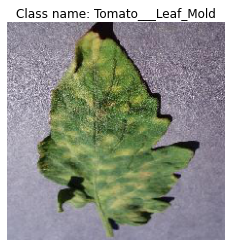

In [ ]:
id = 0
print('The shape of train images: {}'.format(train_generator[id][0][0].shape))
plt.imshow(train_generator[id][0][0])
plt.axis('off')
train_image_label_id = np.argmax(train_generator[id][1][0])
classes_list = list(train_generator.class_indices.keys())
plt.title('Class name: {}'.format(classes_list[train_image_label_id]))
plt.show()


In [ ]:
print(classes_list)

['Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato___Target_Spot', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Tomato___Tomato_mosaic_virus', 'Tomato___healthy']


The shape of validation images: (224, 224, 3)


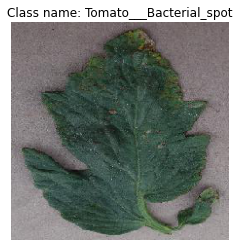

In [ ]:
id = 0
print('The shape of validation images: {}'.format(validation_generator[id][0][0].shape))
plt.imshow(validation_generator[id][0][0])
plt.axis('off')
val_image_label_id = np.argmax(validation_generator[id][1][0])
classes_list = list(validation_generator.class_indices.keys())
plt.title('Class name: {}'.format(classes_list[val_image_label_id]))
plt.show()



The shape of test images: (224, 224, 3)


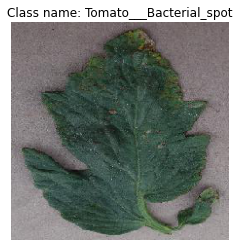

In [ ]:
id = 0
print('The shape of test images: {}'.format(test_generator[id][0][0].shape))
plt.imshow(test_generator[id][0][0])
plt.axis('off')
tes_image_label_id = np.argmax(test_generator[id][1][0])
classes_list = list(test_generator.class_indices.keys())
plt.title('Class name: {}'.format(classes_list[tes_image_label_id]))
plt.show()


## Train the model

In [ ]:
#Compiling the Model
from tensorflow.keras import optimizers
model.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics = ['accuracy'])


In [ ]:
# early stopping training a neural network is to decide how many epochs a model should be trained.
callback = tf.keras.callbacks.EarlyStopping(
    monitor='Val_loss', patience=5)
 #This callback will stop the training when there is no improvement in
# the loss for three consecutive epochs.
model.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics = ['accuracy'])
##Trainig the network
history = model.fit(train_generator, steps_per_epoch=train_generator.samples//train_generator.batch_size, epochs=25, validation_data=validation_generator, 
                    validation_steps=validation_generator.samples//validation_generator.batch_size,callbacks=[callback], verbose=1)

Epoch 1/25
281/281 [==============================] - ETA: 0s - loss: 1.4452 - accuracy: 0.6180

281/281 [==============================] - 2232s 8s/step - loss: 1.4452 - accuracy: 0.6180 - val_loss: 0.6323 - val_accuracy: 0.7887
Epoch 2/25
281/281 [==============================] - ETA: 0s - loss: 0.7106 - accuracy: 0.7589

281/281 [==============================] - 54s 192ms/step - loss: 0.7106 - accuracy: 0.7589 - val_loss: 0.5149 - val_accuracy: 0.8145
Epoch 3/25
281/281 [==============================] - ETA: 0s - loss: 0.6187 - accuracy: 0.7855

281/281 [==============================] - 54s 190ms/step - loss: 0.6187 - accuracy: 0.7855 - val_loss: 0.5357 - val_accuracy: 0.8213
Epoch 4/25
281/281 [==============================] - ETA: 0s - loss: 0.5508 - accuracy: 0.8072

281/281 [==============================] - 54s 192ms/step - loss: 0.5508 - accuracy: 0.8072 - val_loss: 0.4068 - val_accuracy: 0.8560
Epoch 5/25
281/281 [==============================] - ETA: 0s - loss: 0.5422 - accuracy: 0.8116

281/281 [==============================] - 53s 189ms/step - loss: 0.5422 - accuracy: 0.8116 - val_loss: 0.5006 - val_accuracy: 0.8315
Epoch 6/25
281/281 [==============================] - ETA: 0s - loss: 0.5089 - accuracy: 0.8192

281/281 [==============================] - 54s 192ms/step - loss: 0.5089 - accuracy: 0.8192 - val_loss: 0.4400 - val_accuracy: 0.8512
Epoch 7/25
281/281 [==============================] - ETA: 0s - loss: 0.4769 - accuracy: 0.8311

281/281 [==============================] - 54s 192ms/step - loss: 0.4769 - accuracy: 0.8311 - val_loss: 0.4147 - val_accuracy: 0.8560
Epoch 8/25
281/281 [==============================] - ETA: 0s - loss: 0.4400 - accuracy: 0.8422

281/281 [==============================] - 53s 189ms/step - loss: 0.4400 - accuracy: 0.8422 - val_loss: 0.3704 - val_accuracy: 0.8770
Epoch 9/25
281/281 [==============================] - ETA: 0s - loss: 0.3741 - accuracy: 0.8655

281/281 [==============================] - 53s 190ms/step - loss: 0.3741 - accuracy: 0.8655 - val_loss: 0.4032 - val_accuracy: 0.8723
Epoch 10/25
281/281 [==============================] - ETA: 0s - loss: 0.3797 - accuracy: 0.8634

281/281 [==============================] - 54s 192ms/step - loss: 0.3797 - accuracy: 0.8634 - val_loss: 0.4851 - val_accuracy: 0.8533
Epoch 11/25
281/281 [==============================] - ETA: 0s - loss: 0.3361 - accuracy: 0.8788

281/281 [==============================] - 54s 192ms/step - loss: 0.3361 - accuracy: 0.8788 - val_loss: 0.4119 - val_accuracy: 0.8730
Epoch 12/25
281/281 [==============================] - ETA: 0s - loss: 0.3081 - accuracy: 0.8883

281/281 [==============================] - 54s 191ms/step - loss: 0.3081 - accuracy: 0.8883 - val_loss: 0.4763 - val_accuracy: 0.8818
Epoch 13/25
281/281 [==============================] - ETA: 0s - loss: 0.3133 - accuracy: 0.8835

281/281 [==============================] - 53s 189ms/step - loss: 0.3133 - accuracy: 0.8835 - val_loss: 0.3786 - val_accuracy: 0.8818
Epoch 14/25
281/281 [==============================] - ETA: 0s - loss: 0.2948 - accuracy: 0.8936

281/281 [==============================] - 54s 192ms/step - loss: 0.2948 - accuracy: 0.8936 - val_loss: 0.4511 - val_accuracy: 0.8879
Epoch 15/25
281/281 [==============================] - ETA: 0s - loss: 0.2933 - accuracy: 0.8899

281/281 [==============================] - 54s 192ms/step - loss: 0.2933 - accuracy: 0.8899 - val_loss: 0.4783 - val_accuracy: 0.8689
Epoch 16/25
281/281 [==============================] - ETA: 0s - loss: 0.2897 - accuracy: 0.8894

281/281 [==============================] - 54s 192ms/step - loss: 0.2897 - accuracy: 0.8894 - val_loss: 0.4315 - val_accuracy: 0.8689
Epoch 17/25
281/281 [==============================] - ETA: 0s - loss: 0.2861 - accuracy: 0.8941

281/281 [==============================] - 53s 189ms/step - loss: 0.2861 - accuracy: 0.8941 - val_loss: 0.4374 - val_accuracy: 0.8859
Epoch 18/25
281/281 [==============================] - ETA: 0s - loss: 0.2609 - accuracy: 0.9014

281/281 [==============================] - 54s 192ms/step - loss: 0.2609 - accuracy: 0.9014 - val_loss: 0.4492 - val_accuracy: 0.8872
Epoch 19/25
281/281 [==============================] - ETA: 0s - loss: 0.2420 - accuracy: 0.9090

281/281 [==============================] - 53s 189ms/step - loss: 0.2420 - accuracy: 0.9090 - val_loss: 0.4119 - val_accuracy: 0.8899
Epoch 20/25
281/281 [==============================] - ETA: 0s - loss: 0.2244 - accuracy: 0.9166

281/281 [==============================] - 53s 189ms/step - loss: 0.2244 - accuracy: 0.9166 - val_loss: 0.4337 - val_accuracy: 0.8886
Epoch 21/25
281/281 [==============================] - ETA: 0s - loss: 0.2225 - accuracy: 0.9192

281/281 [==============================] - 53s 189ms/step - loss: 0.2225 - accuracy: 0.9192 - val_loss: 0.4429 - val_accuracy: 0.8859
Epoch 22/25
281/281 [==============================] - ETA: 0s - loss: 0.2073 - accuracy: 0.9204

281/281 [==============================] - 53s 189ms/step - loss: 0.2073 - accuracy: 0.9204 - val_loss: 0.4667 - val_accuracy: 0.8818
Epoch 23/25
281/281 [==============================] - ETA: 0s - loss: 0.2644 - accuracy: 0.9034

281/281 [==============================] - 53s 190ms/step - loss: 0.2644 - accuracy: 0.9034 - val_loss: 0.3894 - val_accuracy: 0.8988
Epoch 24/25
281/281 [==============================] - ETA: 0s - loss: 0.2552 - accuracy: 0.9039

281/281 [==============================] - 54s 192ms/step - loss: 0.2552 - accuracy: 0.9039 - val_loss: 0.4442 - val_accuracy: 0.8798
Epoch 25/25
281/281 [==============================] - ETA: 0s - loss: 0.2645 - accuracy: 0.9001

281/281 [==============================] - 53s 189ms/step - loss: 0.2645 - accuracy: 0.9001 - val_loss: 0.5204 - val_accuracy: 0.8832


## visualising accuracy and loss

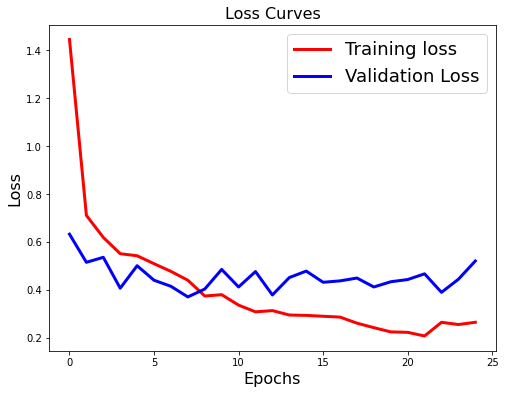

In [ ]:
#loss
plt.figure(figsize=[8, 6])
plt.plot(history.history['loss'], 'r', linewidth=3.0)
plt.plot(history.history['val_loss'], 'b', linewidth=3.0)
plt.legend(['Training loss', 'Validation Loss'], fontsize=18)
plt.xlabel('Epochs', fontsize=16)
plt.ylabel('Loss', fontsize=16)
plt.title('Loss Curves', fontsize=16)
plt.show()

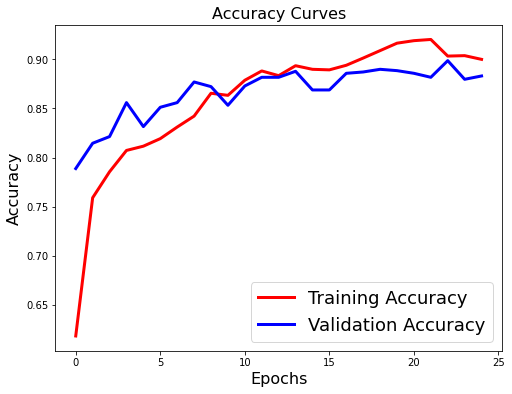

In [ ]:
#accuracy
plt.figure(figsize=[8, 6])
plt.plot(history.history['accuracy'], 'r', linewidth=3.0)
plt.plot(history.history['val_accuracy'], 'b', linewidth=3.0)
plt.legend(['Training Accuracy', 'Validation Accuracy'], fontsize=18)
plt.xlabel('Epochs', fontsize=16)
plt.ylabel('Accuracy', fontsize=16)
plt.title('Accuracy Curves', fontsize=16)
plt.show()

## saving the model

In [ ]:
model.save('/content/drive/MyDrive/Colab Notebooks/myModel.h5')

In [ ]:
from keras.models import load_model
model = model.load_model = load_model('/content/drive/MyDrive/Colab Notebooks/myModel.h5')

In [ ]:
#Getting filenames from generator
fnames = test_generator.filenames
# Get ground truth from generator
ground_truth = test_generator.classes
#get the label to class mapping from generator
label2index = test_generator.class_indices
#obtain the list of the classes
idx2label = dict((v,k) for k,v in label2index.items())
# get the predictions from the model using the generator
predictions = model.predict(test_generator, steps=(test_generator.samples//test_generator.batch_size)+1, verbose=1)
#get the class index to class label
predicted_classes = np.argmax(predictions, axis=1)
errors = np.where(predicted_classes != ground_truth)[0]
print('No of errors = {}/{}'.format(len(errors), test_generator.samples))

47/47 [==============================] - 8s 164ms/step
No of errors = 182/1500


## visualization the errors

Original label: Tomato___Bacterial_spot, Prediction: Tomato___Late_blight, Confidence: 0.900


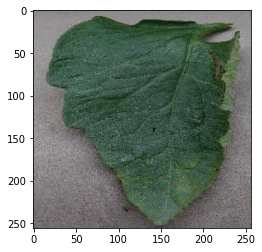

Original label: Tomato___Bacterial_spot, Prediction: Tomato___Late_blight, Confidence: 0.863


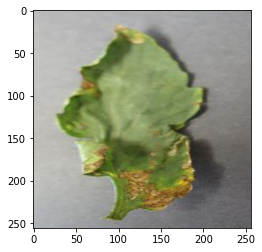

Original label: Tomato___Early_blight, Prediction: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 0.986


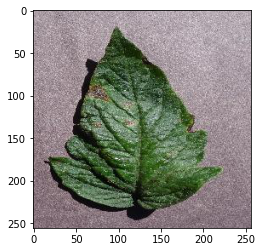

Original label: Tomato___Early_blight, Prediction: Tomato___Target_Spot, Confidence: 0.658


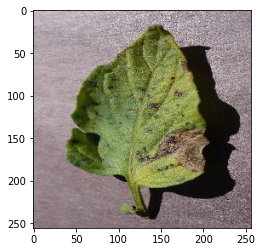

Original label: Tomato___Early_blight, Prediction: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 0.846


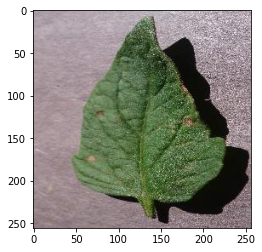

Original label: Tomato___Early_blight, Prediction: Tomato___Bacterial_spot, Confidence: 0.963


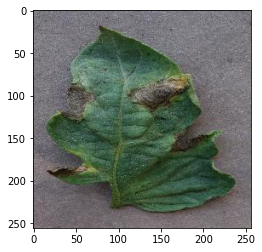

Original label: Tomato___Early_blight, Prediction: Tomato___Target_Spot, Confidence: 0.767


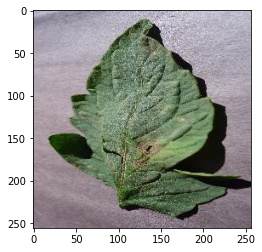

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.994


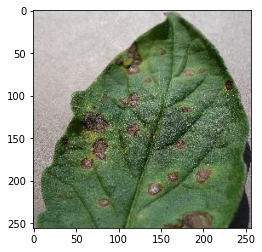

Original label: Tomato___Early_blight, Prediction: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 0.989


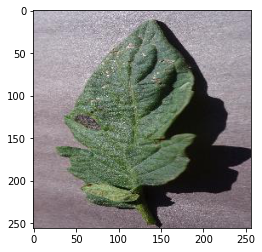

Original label: Tomato___Early_blight, Prediction: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 0.619


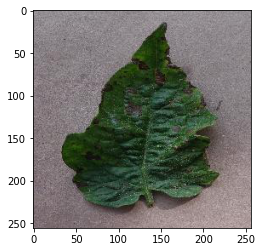

Original label: Tomato___Early_blight, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.740


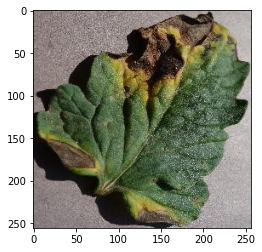

Original label: Tomato___Early_blight, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.742


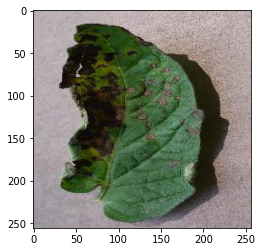

Original label: Tomato___Early_blight, Prediction: Tomato___Bacterial_spot, Confidence: 0.796


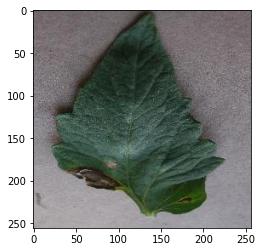

Original label: Tomato___Early_blight, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.960


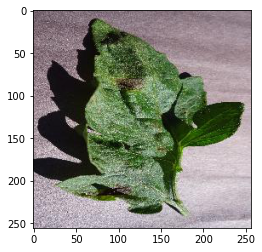

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.981


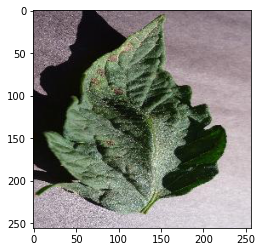

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.995


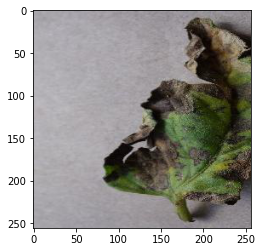

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.999


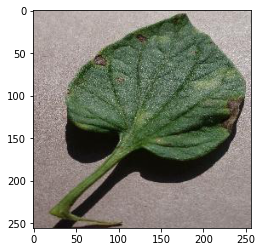

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.507


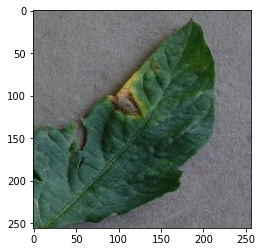

Original label: Tomato___Early_blight, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.723


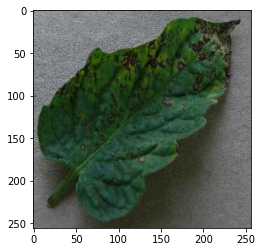

Original label: Tomato___Early_blight, Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Confidence: 0.713


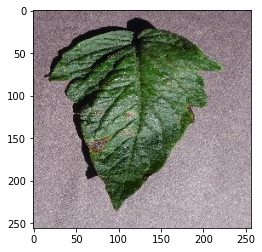

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.959


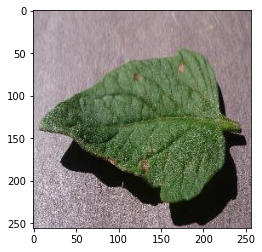

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.981


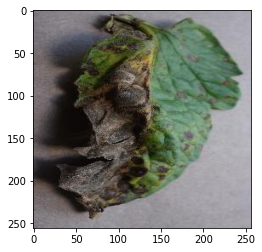

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.982


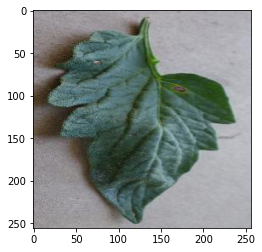

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.982


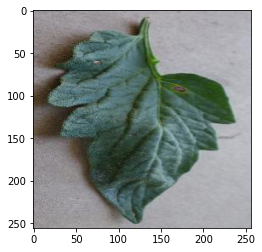

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 1.000


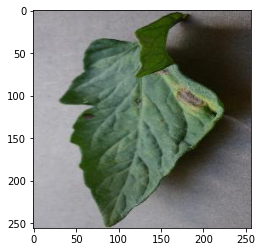

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.993


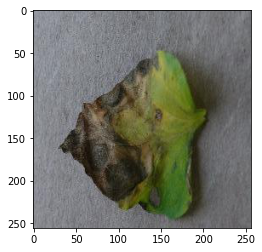

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.989


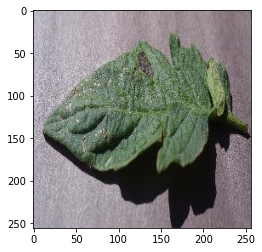

Original label: Tomato___Early_blight, Prediction: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 0.769


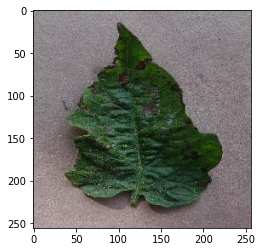

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.726


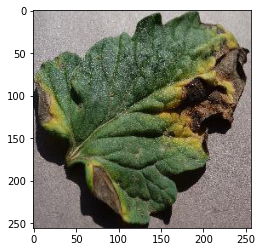

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.726


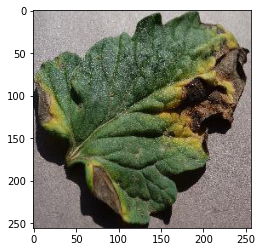

Original label: Tomato___Early_blight, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.998


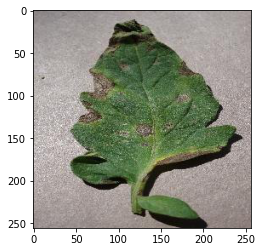

Original label: Tomato___Early_blight, Prediction: Tomato___Bacterial_spot, Confidence: 0.768


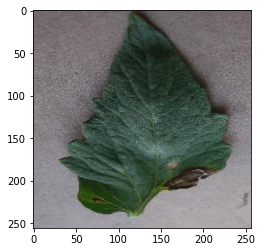

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 1.000


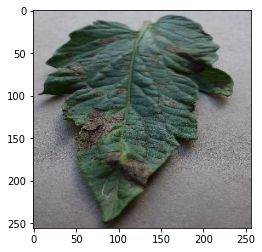

Original label: Tomato___Early_blight, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.973


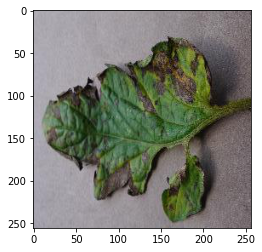

Original label: Tomato___Early_blight, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.650


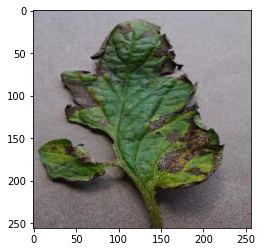

Original label: Tomato___Early_blight, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.973


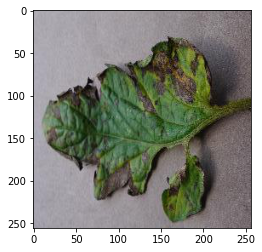

Original label: Tomato___Early_blight, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.773


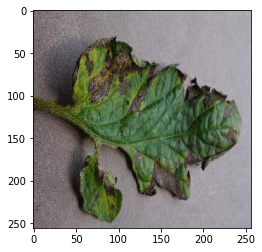

Original label: Tomato___Early_blight, Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Confidence: 0.490


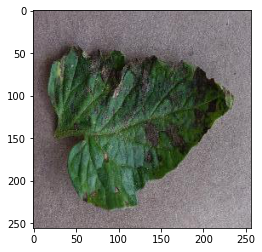

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.994


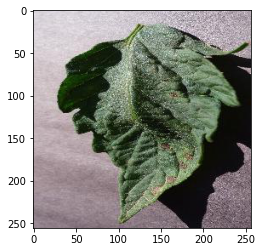

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.999


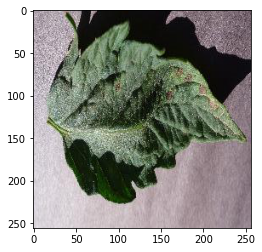

Original label: Tomato___Early_blight, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.875


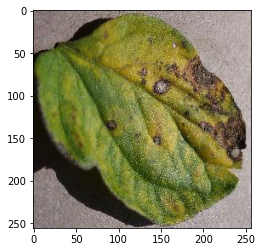

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.655


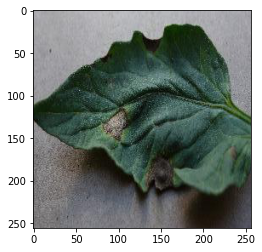

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.689


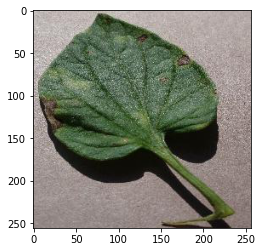

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.985


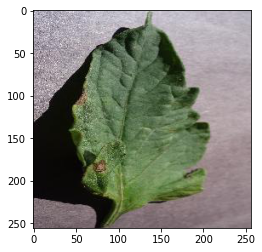

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.999


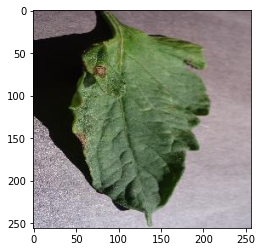

Original label: Tomato___Early_blight, Prediction: Tomato___Late_blight, Confidence: 0.604


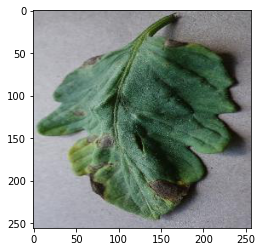

Original label: Tomato___Late_blight, Prediction: Tomato___Early_blight, Confidence: 0.815


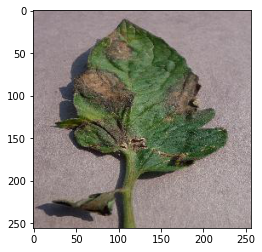

Original label: Tomato___Late_blight, Prediction: Tomato___Early_blight, Confidence: 0.720


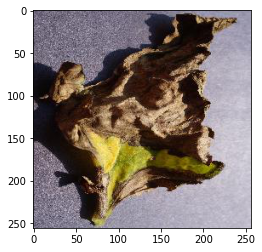

Original label: Tomato___Late_blight, Prediction: Tomato___Leaf_Mold, Confidence: 1.000


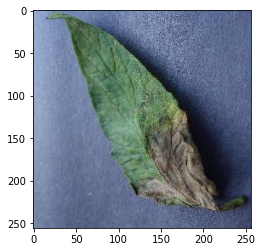

Original label: Tomato___Late_blight, Prediction: Tomato___Early_blight, Confidence: 0.958


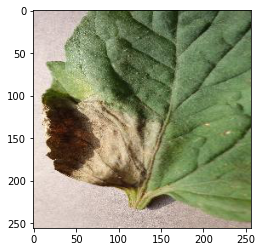

Original label: Tomato___Late_blight, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.992


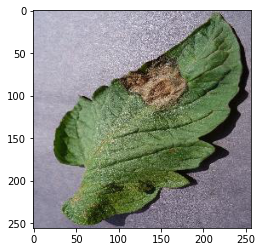

Original label: Tomato___Late_blight, Prediction: Tomato___Early_blight, Confidence: 0.672


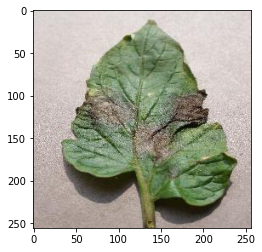

Original label: Tomato___Late_blight, Prediction: Tomato___Early_blight, Confidence: 0.577


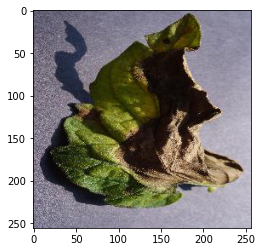

Original label: Tomato___Late_blight, Prediction: Tomato___Septoria_leaf_spot, Confidence: 1.000


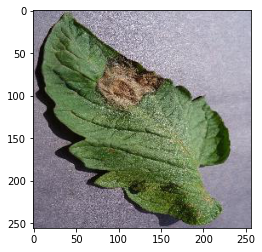

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 0.569


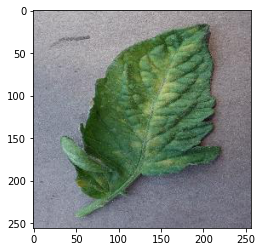

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Tomato_mosaic_virus, Confidence: 0.563


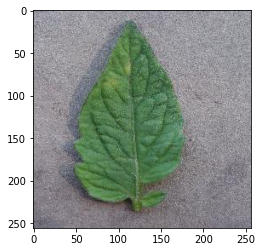

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.939


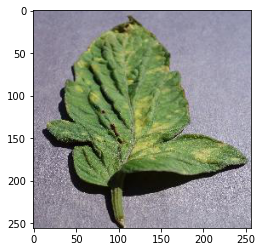

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Early_blight, Confidence: 0.996


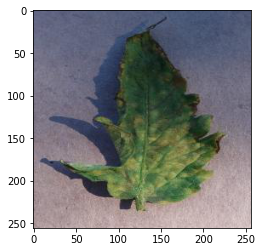

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.988


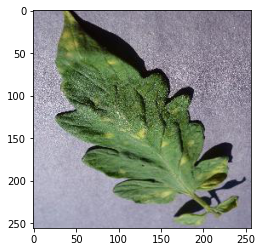

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Early_blight, Confidence: 0.690


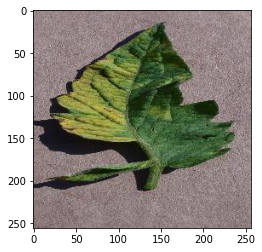

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Late_blight, Confidence: 0.507


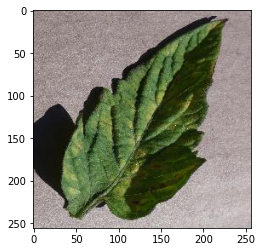

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.528


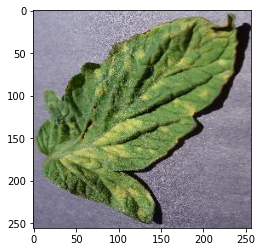

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Early_blight, Confidence: 0.841


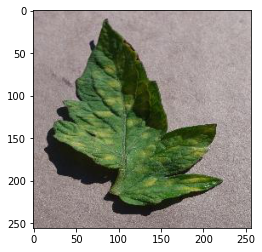

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Late_blight, Confidence: 0.550


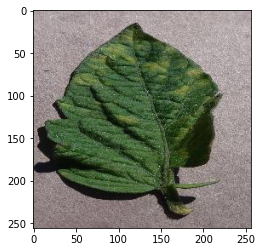

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Late_blight, Confidence: 0.488


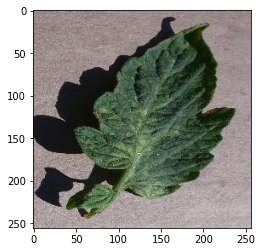

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Confidence: 0.385


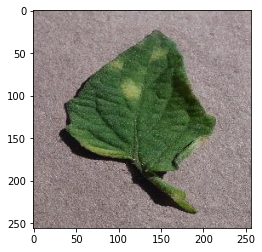

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Confidence: 0.988


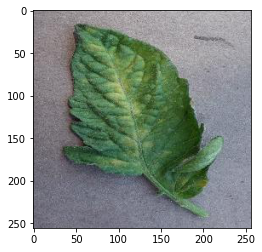

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Tomato_mosaic_virus, Confidence: 0.930


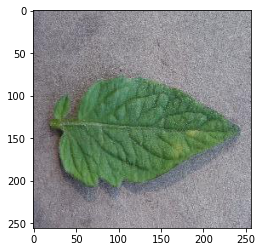

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.961


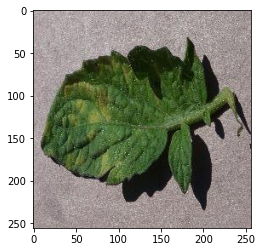

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Tomato_mosaic_virus, Confidence: 0.762


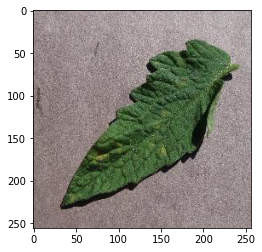

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.379


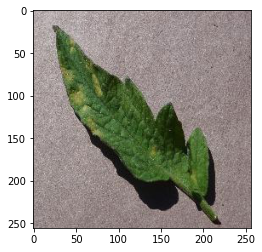

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.405


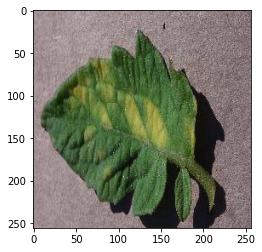

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.405


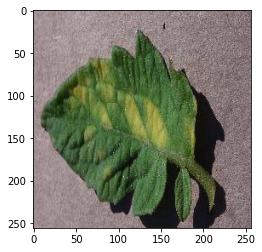

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Early_blight, Confidence: 0.820


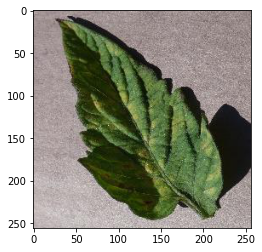

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Late_blight, Confidence: 1.000


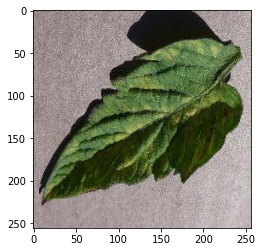

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.852


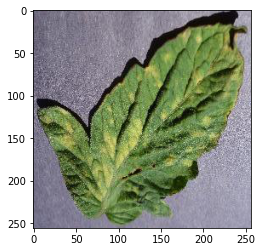

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Late_blight, Confidence: 0.819


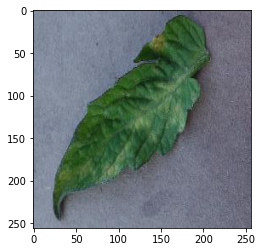

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Tomato_mosaic_virus, Confidence: 0.930


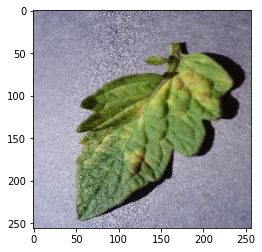

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Confidence: 0.411


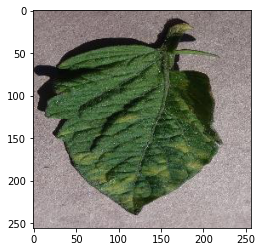

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Late_blight, Confidence: 0.891


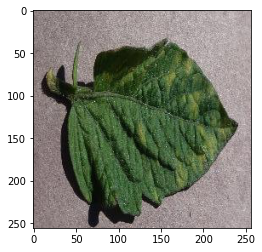

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Early_blight, Confidence: 0.767


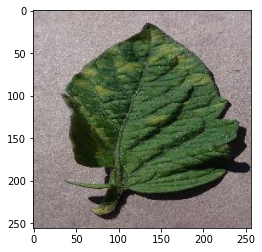

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.695


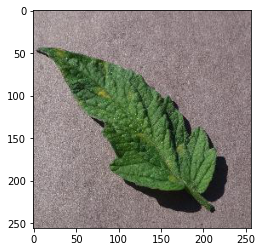

Original label: Tomato___Leaf_Mold, Prediction: Tomato___Early_blight, Confidence: 0.959


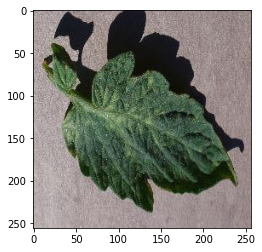

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Early_blight, Confidence: 0.901


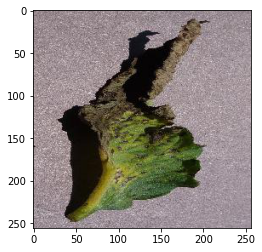

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Bacterial_spot, Confidence: 0.972


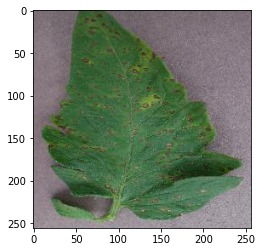

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Late_blight, Confidence: 0.663


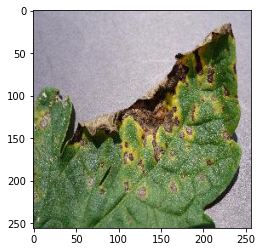

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Early_blight, Confidence: 0.990


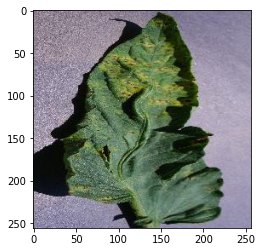

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Late_blight, Confidence: 0.998


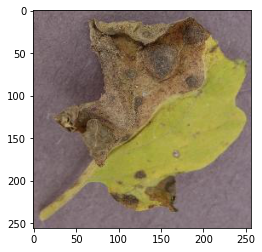

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 0.376


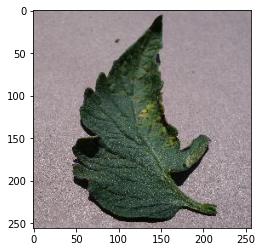

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Bacterial_spot, Confidence: 0.685


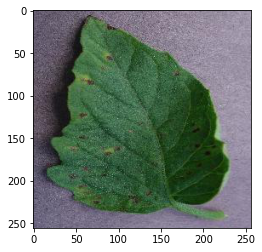

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Leaf_Mold, Confidence: 1.000


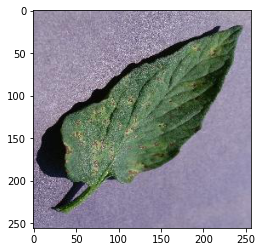

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Late_blight, Confidence: 0.808


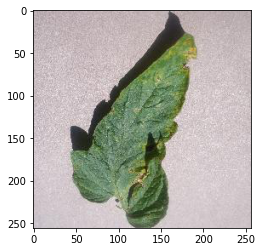

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Late_blight, Confidence: 0.640


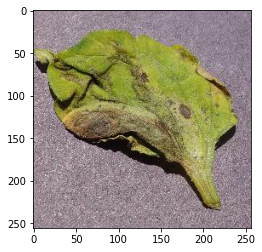

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Early_blight, Confidence: 0.966


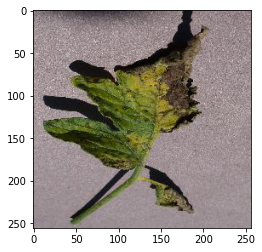

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Bacterial_spot, Confidence: 0.871


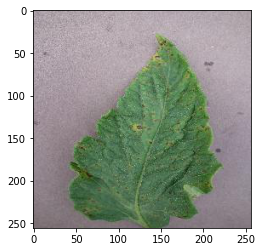

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Late_blight, Confidence: 0.994


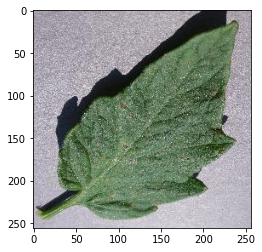

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Early_blight, Confidence: 0.518


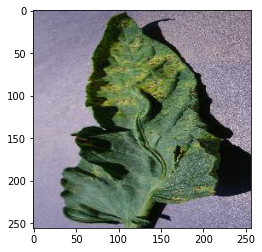

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Late_blight, Confidence: 0.998


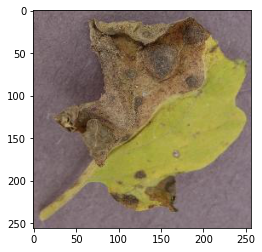

Original label: Tomato___Septoria_leaf_spot, Prediction: Tomato___Late_blight, Confidence: 0.551


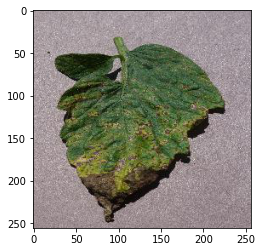

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Target_Spot, Confidence: 0.917


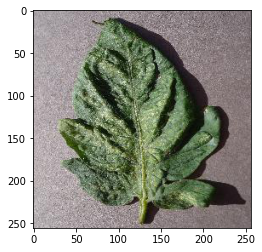

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Target_Spot, Confidence: 0.586


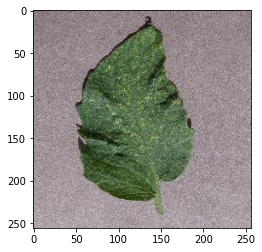

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Target_Spot, Confidence: 0.922


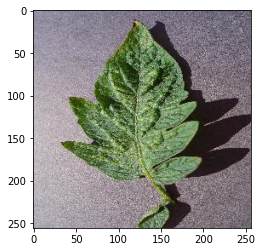

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Target_Spot, Confidence: 0.982


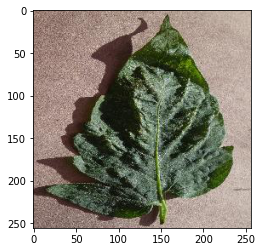

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Tomato_mosaic_virus, Confidence: 0.801


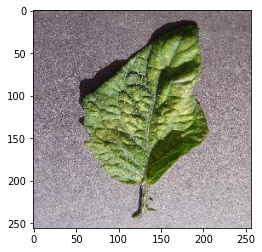

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Target_Spot, Confidence: 0.526


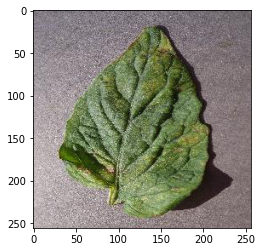

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Target_Spot, Confidence: 0.629


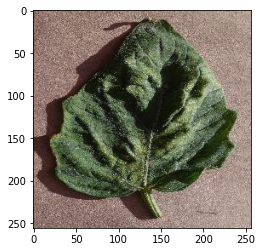

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Target_Spot, Confidence: 0.993


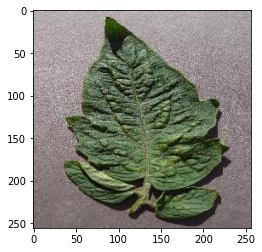

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Target_Spot, Confidence: 0.970


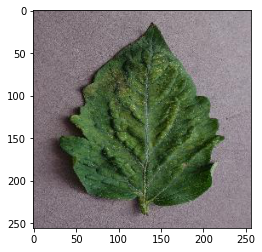

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Target_Spot, Confidence: 0.966


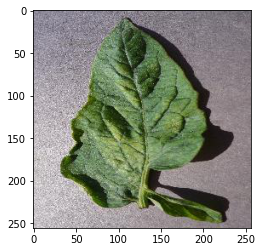

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Target_Spot, Confidence: 0.973


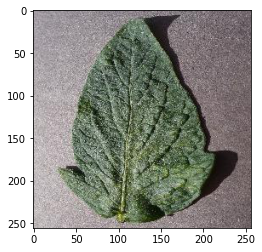

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Late_blight, Confidence: 0.858


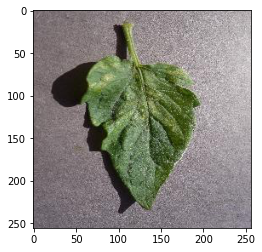

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Late_blight, Confidence: 0.858


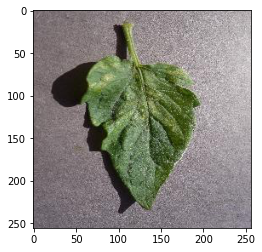

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Tomato_mosaic_virus, Confidence: 0.914


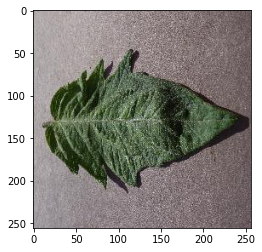

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Late_blight, Confidence: 0.830


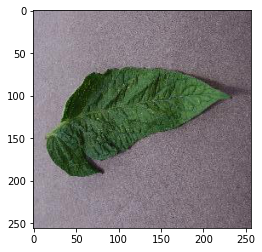

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Target_Spot, Confidence: 0.469


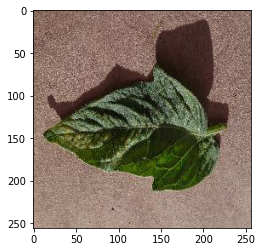

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Tomato_mosaic_virus, Confidence: 0.993


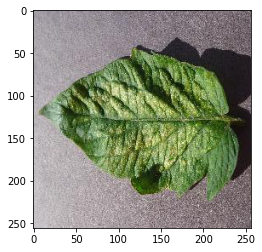

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Tomato_mosaic_virus, Confidence: 0.999


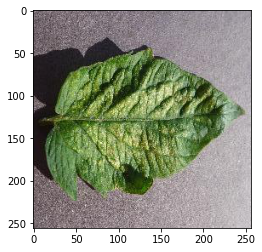

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Tomato_mosaic_virus, Confidence: 0.969


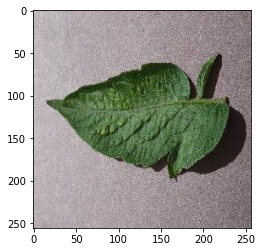

Original label: Tomato___Spider_mites Two-spotted_spider_mite, Prediction: Tomato___Leaf_Mold, Confidence: 0.330


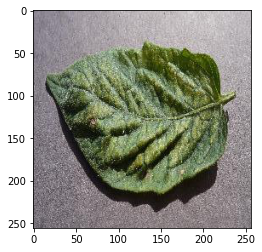

Original label: Tomato___Target_Spot, Prediction: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 0.589


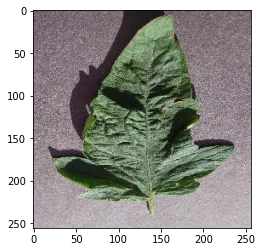

Original label: Tomato___Target_Spot, Prediction: Tomato___Late_blight, Confidence: 0.616


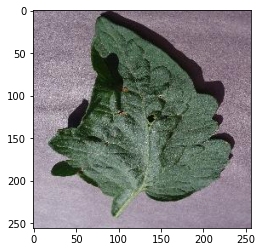

Original label: Tomato___Target_Spot, Prediction: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 0.649


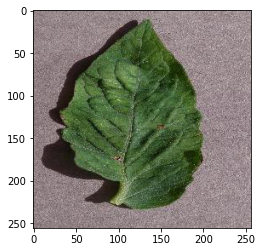

Original label: Tomato___Target_Spot, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.688


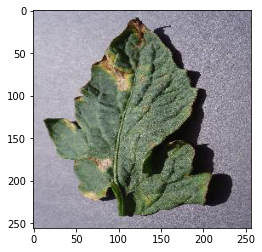

Original label: Tomato___Target_Spot, Prediction: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 0.657


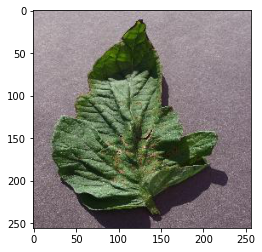

Original label: Tomato___Target_Spot, Prediction: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 0.740


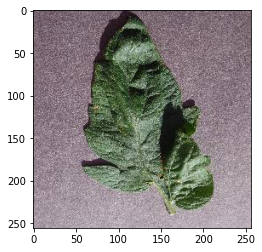

Original label: Tomato___Target_Spot, Prediction: Tomato___Late_blight, Confidence: 0.852


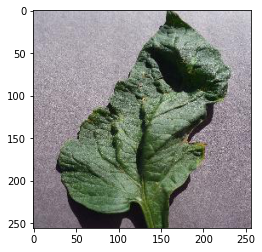

Original label: Tomato___Target_Spot, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.428


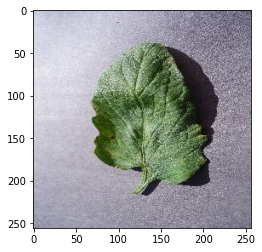

Original label: Tomato___Target_Spot, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.820


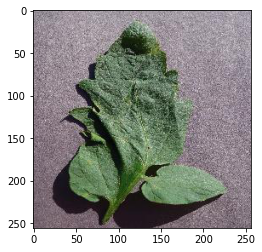

Original label: Tomato___Target_Spot, Prediction: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 0.990


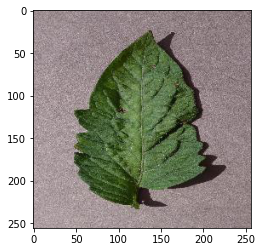

Original label: Tomato___Target_Spot, Prediction: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 0.603


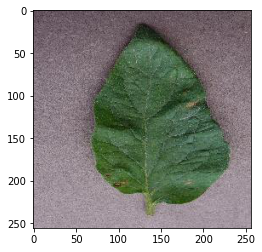

Original label: Tomato___Target_Spot, Prediction: Tomato___Late_blight, Confidence: 0.740


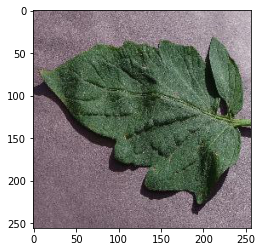

Original label: Tomato___Target_Spot, Prediction: Tomato___Late_blight, Confidence: 0.889


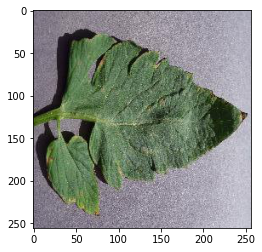

Original label: Tomato___Target_Spot, Prediction: Tomato___healthy, Confidence: 0.788


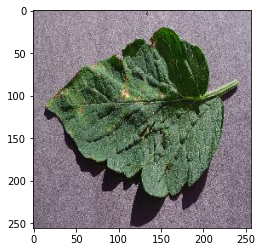

Original label: Tomato___Target_Spot, Prediction: Tomato___Late_blight, Confidence: 0.628


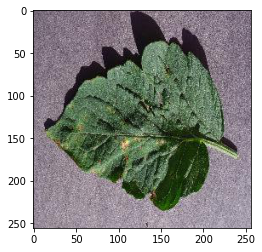

Original label: Tomato___Target_Spot, Prediction: Tomato___Late_blight, Confidence: 0.993


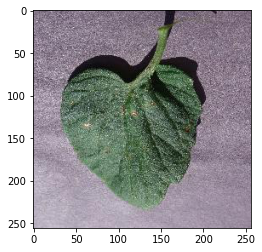

Original label: Tomato___Target_Spot, Prediction: Tomato___Late_blight, Confidence: 0.494


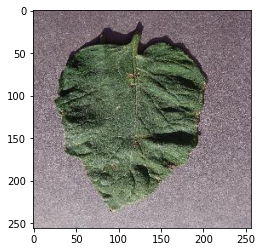

Original label: Tomato___Target_Spot, Prediction: Tomato___Tomato_mosaic_virus, Confidence: 0.583


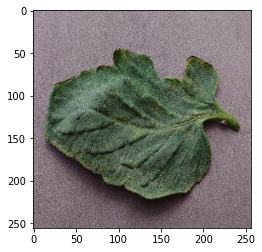

Original label: Tomato___Target_Spot, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.492


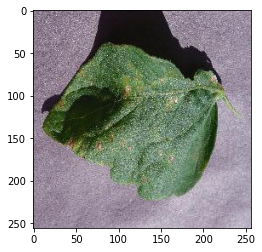

Original label: Tomato___Target_Spot, Prediction: Tomato___Late_blight, Confidence: 0.647


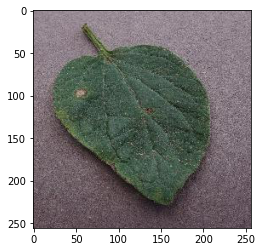

Original label: Tomato___Target_Spot, Prediction: Tomato___Late_blight, Confidence: 0.846


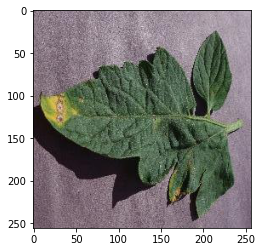

Original label: Tomato___Target_Spot, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.831


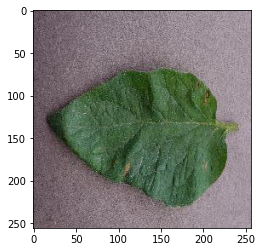

Original label: Tomato___Target_Spot, Prediction: Tomato___Late_blight, Confidence: 0.482


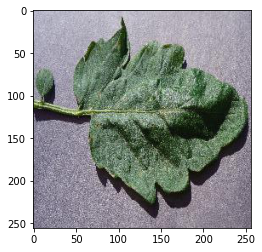

Original label: Tomato___Target_Spot, Prediction: Tomato___Late_blight, Confidence: 1.000


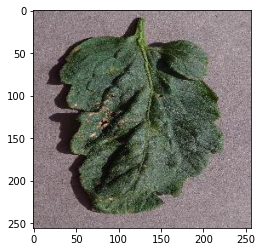

Original label: Tomato___Target_Spot, Prediction: Tomato___Late_blight, Confidence: 0.840


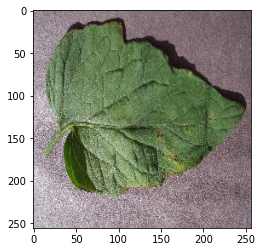

Original label: Tomato___Target_Spot, Prediction: Tomato___Late_blight, Confidence: 0.869


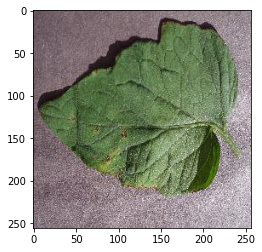

Original label: Tomato___Target_Spot, Prediction: Tomato___Late_blight, Confidence: 0.519


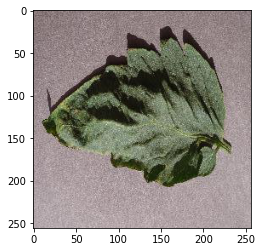

Original label: Tomato___Target_Spot, Prediction: Tomato___Late_blight, Confidence: 0.978


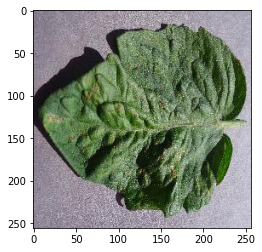

Original label: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Prediction: Tomato___Bacterial_spot, Confidence: 0.945


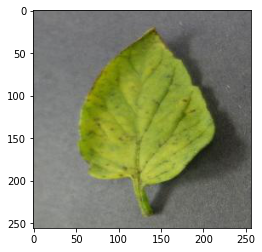

Original label: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Prediction: Tomato___Bacterial_spot, Confidence: 0.969


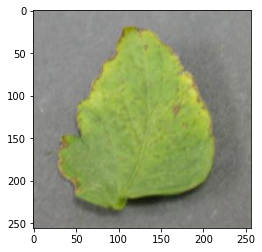

Original label: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Prediction: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 0.947


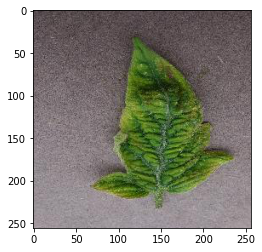

Original label: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Prediction: Tomato___Bacterial_spot, Confidence: 0.915


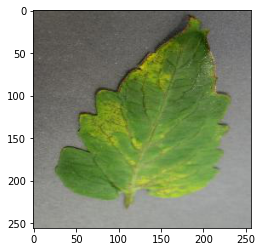

Original label: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Prediction: Tomato___Bacterial_spot, Confidence: 0.989


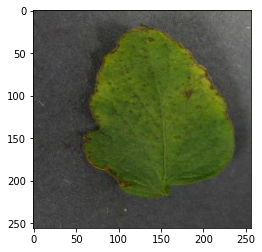

Original label: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Prediction: Tomato___Tomato_mosaic_virus, Confidence: 0.940


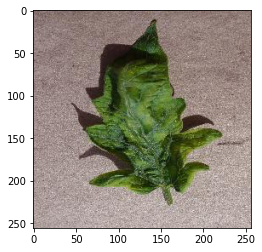

Original label: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Prediction: Tomato___Bacterial_spot, Confidence: 0.691


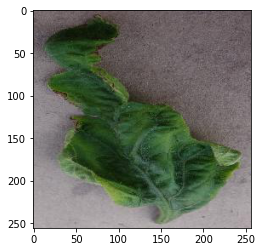

Original label: Tomato___Tomato_Yellow_Leaf_Curl_Virus, Prediction: Tomato___Bacterial_spot, Confidence: 0.526


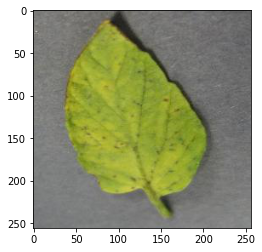

Original label: Tomato___Tomato_mosaic_virus, Prediction: Tomato___Spider_mites Two-spotted_spider_mite, Confidence: 0.806


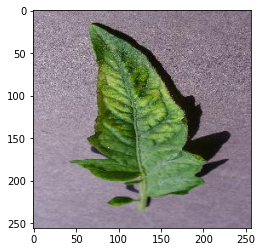

Original label: Tomato___Tomato_mosaic_virus, Prediction: Tomato___Leaf_Mold, Confidence: 0.999


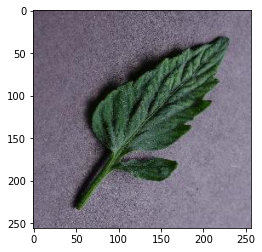

Original label: Tomato___Tomato_mosaic_virus, Prediction: Tomato___Leaf_Mold, Confidence: 0.851


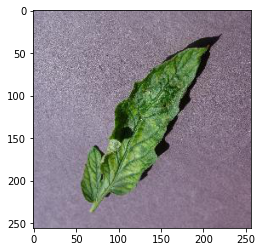

Original label: Tomato___Tomato_mosaic_virus, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.515


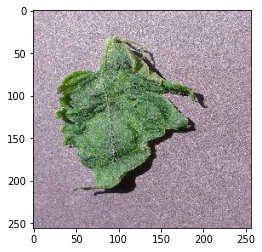

Original label: Tomato___Tomato_mosaic_virus, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.515


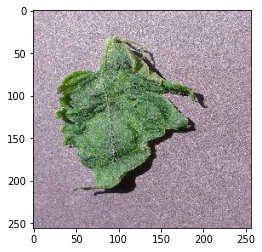

Original label: Tomato___healthy, Prediction: Tomato___Target_Spot, Confidence: 0.856


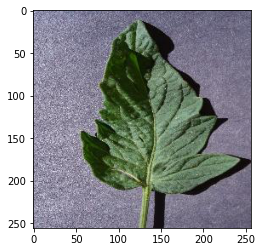

Original label: Tomato___healthy, Prediction: Tomato___Target_Spot, Confidence: 0.954


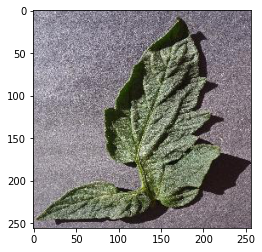

Original label: Tomato___healthy, Prediction: Tomato___Target_Spot, Confidence: 0.703


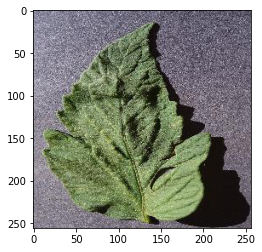

Original label: Tomato___healthy, Prediction: Tomato___Target_Spot, Confidence: 0.935


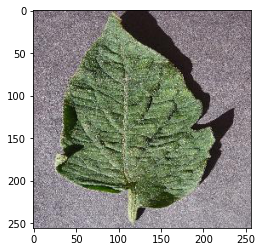

Original label: Tomato___healthy, Prediction: Tomato___Target_Spot, Confidence: 0.999


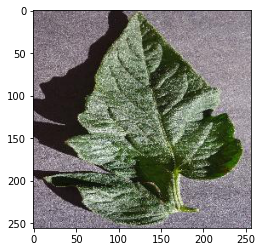

Original label: Tomato___healthy, Prediction: Tomato___Leaf_Mold, Confidence: 0.541


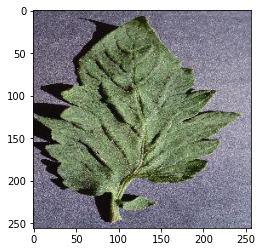

Original label: Tomato___healthy, Prediction: Tomato___Target_Spot, Confidence: 0.828


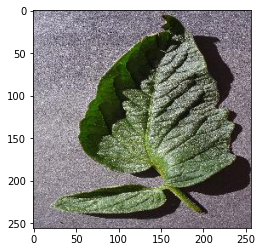

Original label: Tomato___healthy, Prediction: Tomato___Target_Spot, Confidence: 0.657


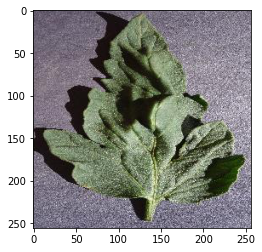

Original label: Tomato___healthy, Prediction: Tomato___Target_Spot, Confidence: 0.959


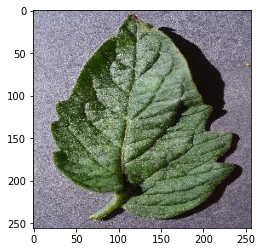

Original label: Tomato___healthy, Prediction: Tomato___Target_Spot, Confidence: 0.521


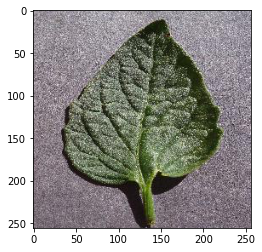

Original label: Tomato___healthy, Prediction: Tomato___Target_Spot, Confidence: 0.997


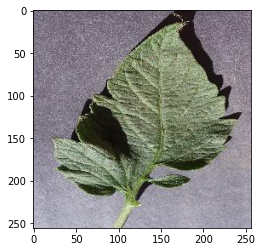

Original label: Tomato___healthy, Prediction: Tomato___Target_Spot, Confidence: 1.000


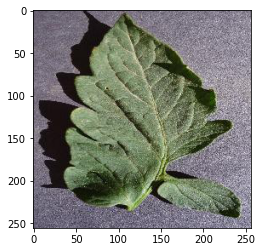

Original label: Tomato___healthy, Prediction: Tomato___Tomato_mosaic_virus, Confidence: 0.999


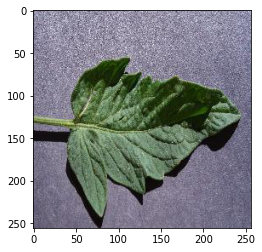

Original label: Tomato___healthy, Prediction: Tomato___Tomato_mosaic_virus, Confidence: 0.741


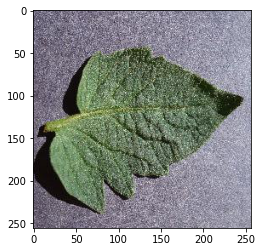

Original label: Tomato___healthy, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.998


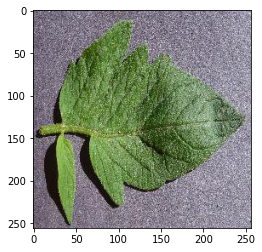

Original label: Tomato___healthy, Prediction: Tomato___Late_blight, Confidence: 0.933


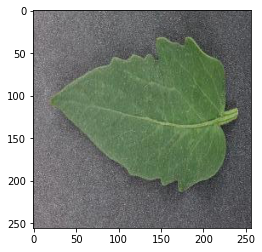

Original label: Tomato___healthy, Prediction: Tomato___Septoria_leaf_spot, Confidence: 0.932


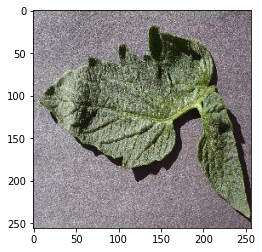

Original label: Tomato___healthy, Prediction: Tomato___Tomato_mosaic_virus, Confidence: 0.779


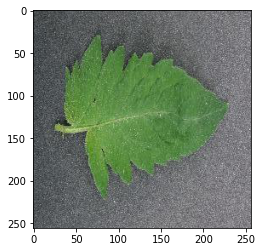

Original label: Tomato___healthy, Prediction: Tomato___Late_blight, Confidence: 0.760


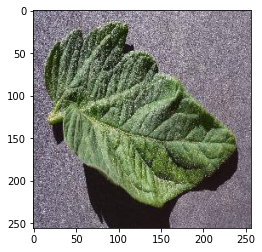

Original label: Tomato___healthy, Prediction: Tomato___Late_blight, Confidence: 0.989


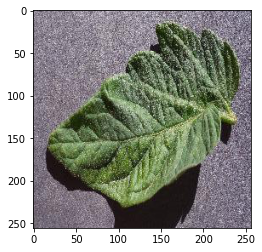

Original label: Tomato___healthy, Prediction: Tomato___Late_blight, Confidence: 1.000


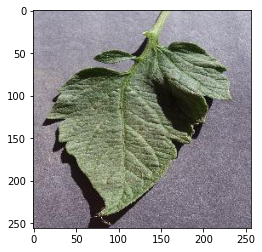

Original label: Tomato___healthy, Prediction: Tomato___Late_blight, Confidence: 1.000


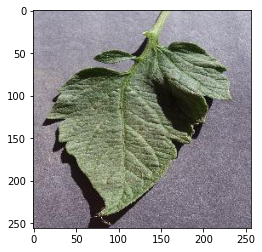

In [ ]:
#show the errors
from tensorflow.keras.preprocessing.image import load_img
for i in range(len(errors)):
    pred_class = np.argmax(predictions[errors[i]])
    pred_label = idx2label[pred_class]
    print('Original label: {}, Prediction: {}, Confidence: {:.3f}'.format(fnames[errors[i]].split('/')[0], pred_label, predictions[errors[i]][pred_class]))
    original = load_img('{}/{}'.format(test_dir, fnames[errors[i]]))
    plt.imshow(original)
    plt.show()

## predicting

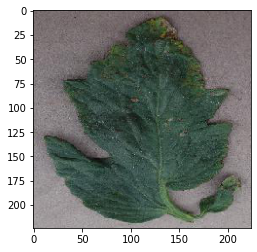

Prediction: Tomato___Septoria_leaf_spot


In [ ]:
#load an image
from tensorflow.keras.preprocessing.image import img_to_array
filename = '/content/drive/MyDrive/dataset/archive ....zip (Unzipped Files)/archive/tomato/test/Tomato___Bacterial_spot/01a3cf3f-94c1-44d5-8972-8c509d62558e___GCREC_Bact.Sp 3396.JPG'
original = load_img(filename, target_size=(224, 224))
# numpy image height, width, channel
numpy_image = img_to_array(original)
#convert the image into batch format
#expand_dims will add an extra dimension to the data at a particular axis
#we want the input matrix to the network to be the form(batchsize, height, width, channels)
image_batch = np.expand_dims(numpy_image, axis=0)
plt.imshow(np.uint8(image_batch[0]))
plt.show()
prediction = np.argmax(model.predict(image_batch), axis=1)
probability = model.predict(image_batch)
predicted_class = np.argmax(probability[0])
predict_label = idx2label[predicted_class]
print('Prediction: {}'.format(predict_label))

In [ ]:
model.evaluate(test_generator)

47/47 [==============================] - 8s 160ms/step - loss: 0.5778 - accuracy: 0.8787


[0.5777933597564697, 0.8786666393280029]